코드가 두 부분으로 나누어져 있습니다.
위에 부분은 개별 파일을 spectrogram으로 변환하는 방법이고 밑에 부분은 폴더 안에 있는 모든 소리 파일을 spectrogram으로 변환하는 방법입니다.
대신 맨 윗줄에 있는 모듈을 불러오는 셀은 무조건 실행해야 됩니다.

In [ ]:
import librosa
import librosa.display
import IPython.display
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import matplotlib.font_manager as fm
%matplotlib inline
import os

#소리 파일 각각 확인
#audio_path = '/content/drive/My Drive/Colab Notebooks/Capston/spectrogram/1_밥/밥2.wav'
#y, sr = librosa.load(audio_path, sr=44100)

In [ ]:
#add noise
'''
def add_noise(data):
    wn = np.random.randn(len(data))
    data_wn = data + 0.005*wn
    return data_wn

an=add_noise(y)
'''

In [ ]:
#mix music
'''
bgm_file = '/content/drive/My Drive/Colab Notebooks/Capston/audio/Happy_Cafe.mp3'
y_b, _ = librosa.core.load(bgm_file, sr = 22050, duration = 200)
rand_offset = int(np.random.randint(len(y_b)-len(y)-1, size=1))
rand_bgm = y_b[rand_offset:(rand_offset+len(y))]
y_new = y + rand_bgm/28
'''

In [ ]:
#check to sound
#data가 y면 원본, an이면 잡음추가한 소리, y_new면 노래 추가한 소리
#IPython.display.Audio(data=y, rate=sr)

In [ ]:
#convert sound to spectrogram
min_level_db = -100
def _normalize(S):
  return np.clip((S - min_level_db) / -min_level_db, 0, 1)

S = librosa.feature.melspectrogram(y, sr=sr, n_mels=128)
log_S = librosa.amplitude_to_db(S, ref=np.max)
plt.figure(figsize=(4, 4))
norm_S = _normalize(log_S)
librosa.display.specshow(norm_S, sr=sr)
plt.tight_layout()
plt.show()

## 여기서부터는 폴더 안에 있는 모든 파일을 변환하는 코드

In [ ]:
from os import listdir
from os.path import isfile, join
import numpy
files=[]
wav_path = '/content/drive/My Drive/Colab Notebooks/Capston/audio/0_물'#소리 원본이 위치한 폴더 경로
files = [f for f in listdir(wav_path) if isfile(join(wav_path, f))]#모든 소리 파일
audio = numpy.empty(len(files), dtype=object)

In [ ]:
def add_noise(data):
    wn = np.random.randn(len(data))
    data_wn = data + 0.005*wn
    return data_wn

In [ ]:
#노래 추가
bgm_file = '/content/drive/My Drive/Colab Notebooks/Capston/audio/Happy_Cafe.mp3'#추가할 노래 지정
y_b, _ = librosa.core.load(bgm_file, sr = 22050, duration = 200)

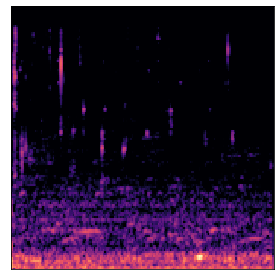

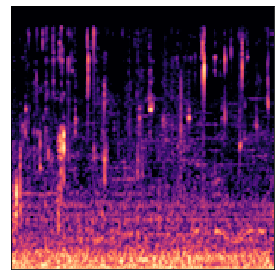

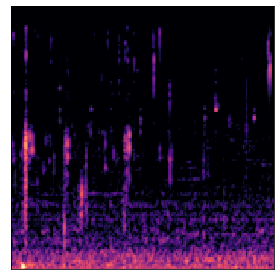

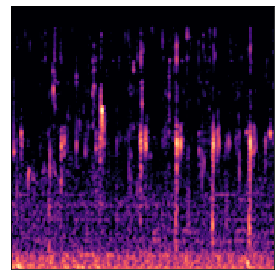

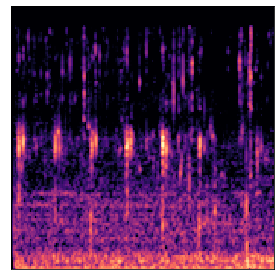

...

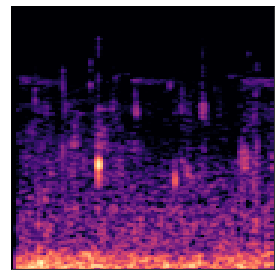

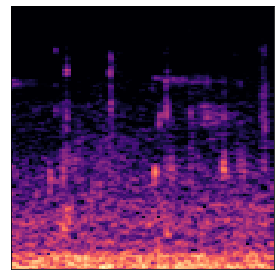

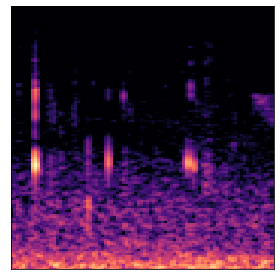

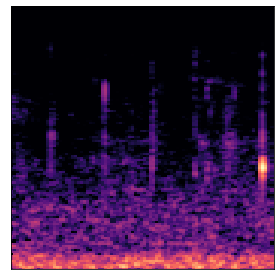

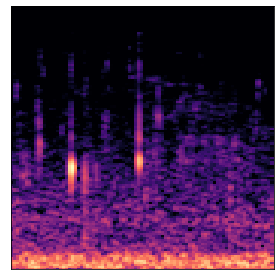

In [ ]:
#범위를 0-1dB로 Normalization
min_level_db = -100

def _normalize(S):
  return np.clip((S - min_level_db) / -min_level_db, 0, 1)

for n in range(0, len(files)):
  fn = join(wav_path, files[n])
  y, sr = librosa.load(fn, sr=44100)
  
  #노래를 추가하려면 밑에 세줄만 추가
  #rand_offset = int(np.random.randint(len(y_b)-len(y)-1, size=1))
  #rand_bgm = y_b[rand_offset:(rand_offset+len(y))]
  #y_new = y + rand_bgm/28
  
  #잡음을 추가하려면 밑에 한줄만 추가
  #an = add_noise(y)

  #y를 an, y_new으로 변경하면서 사용(잡음, 노래를 추가할 경우)
  S = librosa.feature.melspectrogram(y, sr=sr, n_mels=128)

  log_S = librosa.amplitude_to_db(S, ref=np.max)
  norm_S = _normalize(log_S)
  plt.figure(figsize=(4, 4))
  librosa.display.specshow(norm_S, sr=sr)
  plt.tight_layout()
  fig = plt.gcf()
  plt.show()
  fig.savefig('/content/drive/My Drive/Colab Notebooks/Capston/data/0_normal/water{}.png'.format(n+1) )#spectrogram이 저장될 폴더와 파일명